In [1]:
import argparse
import os
from pathlib import Path
import numpy as np
import pandas as pd
import pickle
import scipy.io as sio

import unicorn_utils as utils

pd.options.mode.chained_assignment = None  # default='warn'

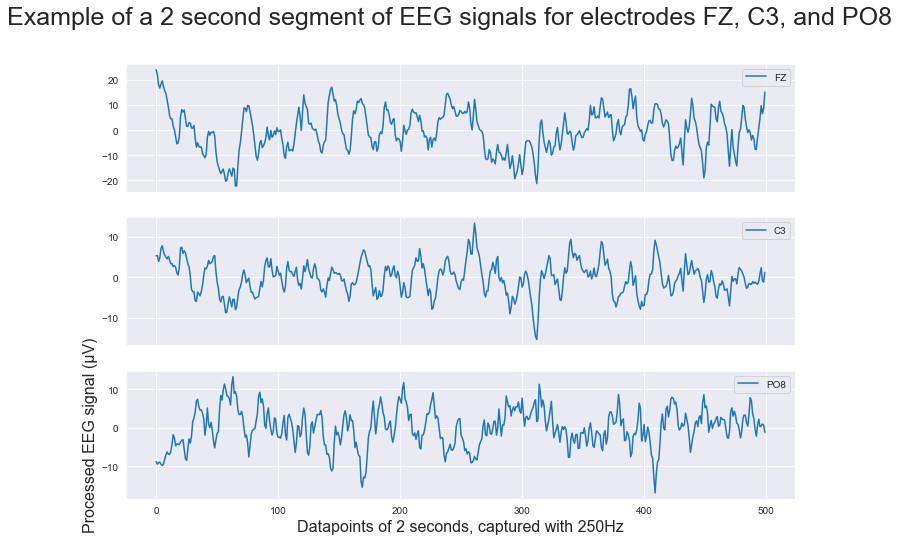

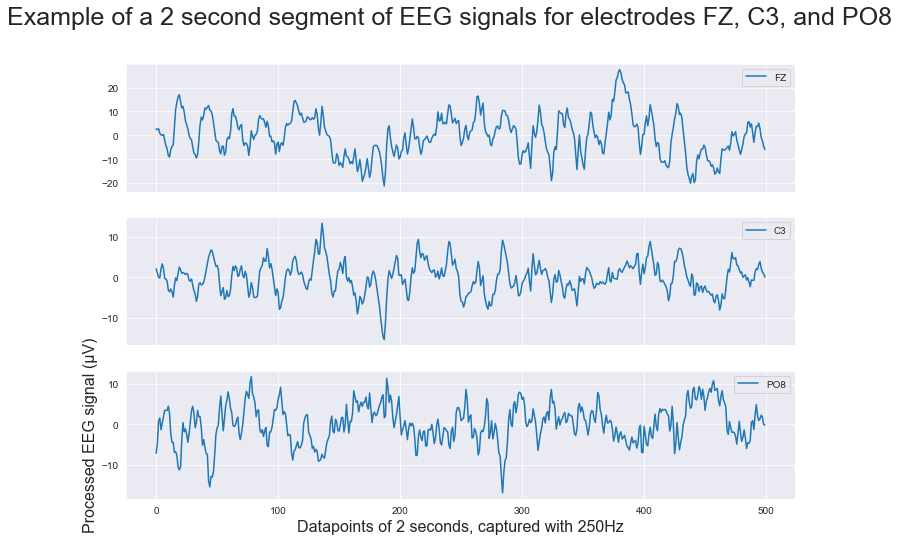

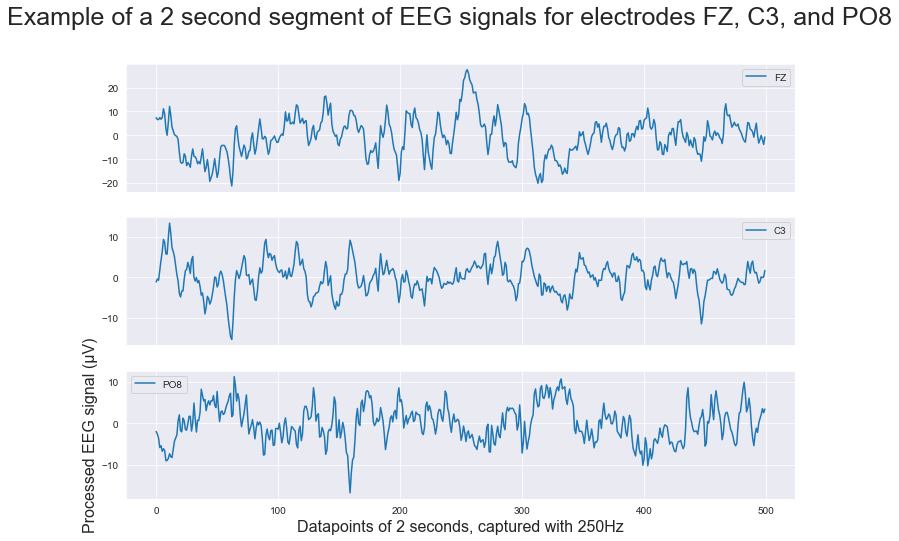

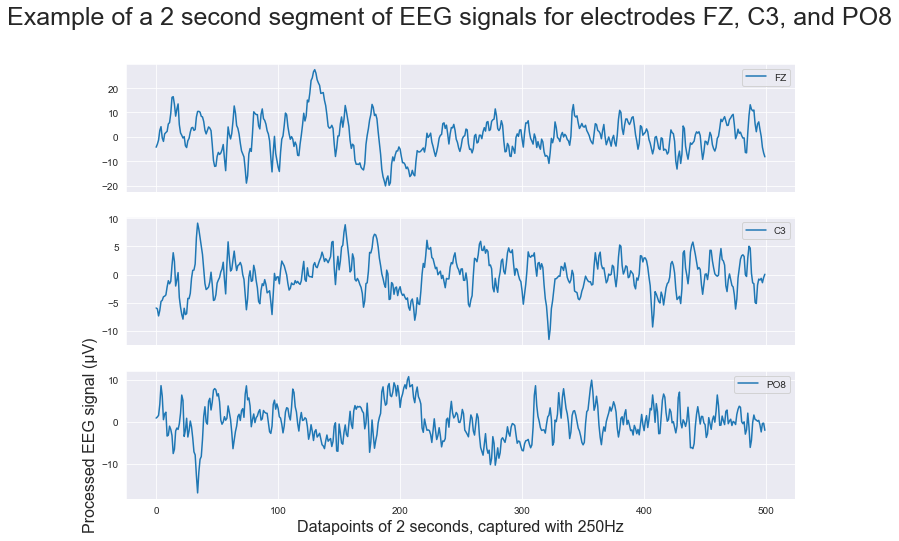

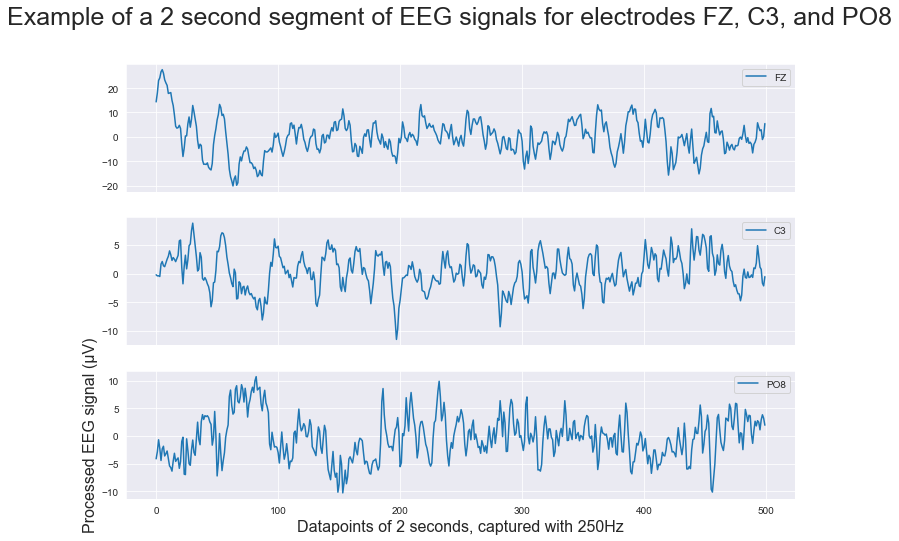

...

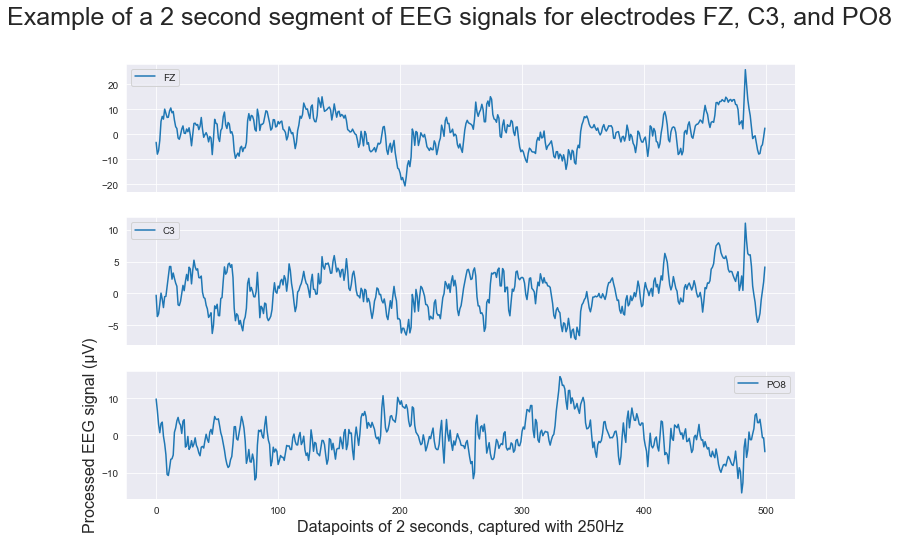

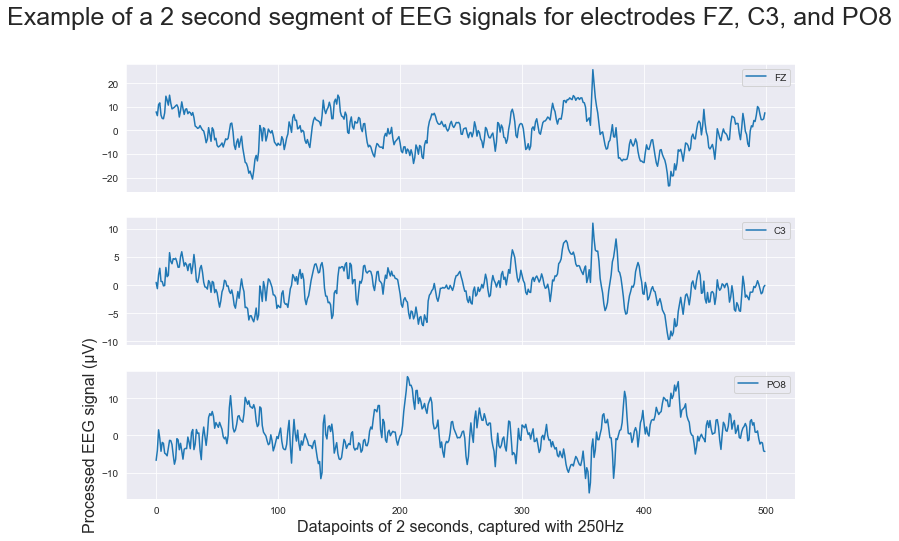

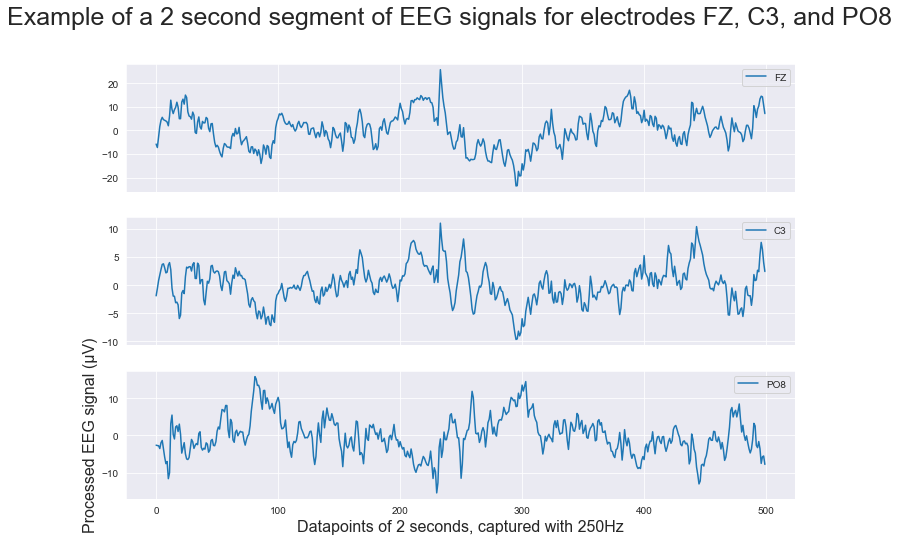

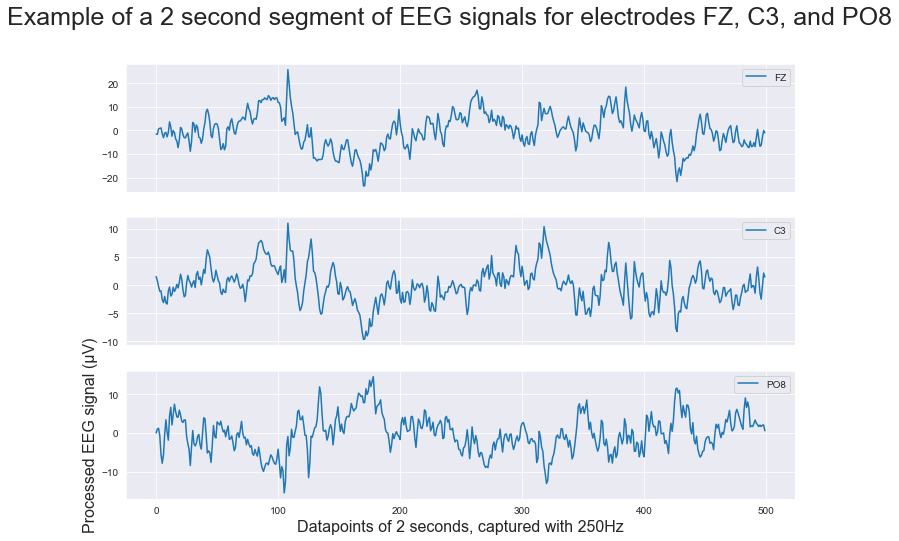

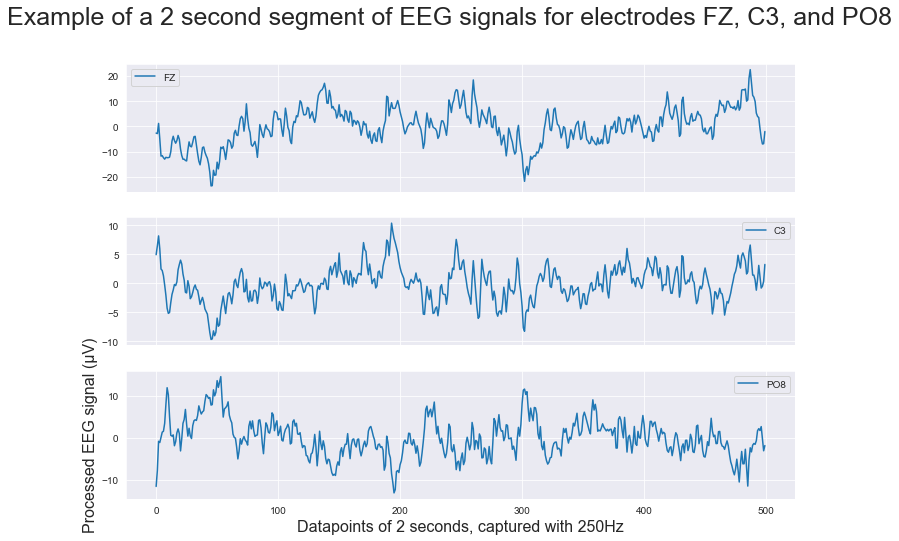

In [4]:
from pathlib import Path
from numpy import size
import pandas as pd
import pickle
import matplotlib.pyplot as plt
pd.options.mode.chained_assignment = None  # default='warn'
# Load packages
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns 
sns.set_style('darkgrid')

# F:\Academics\M2 CNN\Semester 2\BMI Lab Elche\Project\Final trials\Legs\Closed Loop Trials\data\preprocess\colab
sampling_frequency = 250
# testing here for 8 electrodes:
electrode_names =  ['FZ', 'C3', 'CZ', 'C4', 'PZ', 'PO7', 'OZ', 'PO8']
n_electrodes = len(electrode_names)
file_path = Path(f"./data/preprocess/colab/X02_wet_filtord2_freqlimits['1_100Hz']_ws500.pkl")
a_file = open(file_path, "rb")
data_dict = pickle.load(a_file)
X = data_dict['data']
y = data_dict['labels']

for df in X: 
    segments=0
    for segment in range(len(X[df])):
        if y[df][segment] == 1:
            current_seg = X[df][segment].T
            current_seg.columns = ['FZ', 'C3', 'CZ', 'C4', 'PZ', 'PO7', 'OZ', 'PO8']
            current_seg.drop(['CZ', 'C4', 'PZ', 'PO7', 'OZ'], axis=1, inplace=True)
            plt.rcParams['figure.figsize'] = (12, 8)
            plt.rcParams["legend.loc"] = 'upper right'
            current_seg.plot(subplots=True, legend=True, color='tab:blue', sharex=True, sharey=False)
            plt.xlabel('Datapoints of 2 seconds, captured with 250Hz', size=16)
            plt.ylabel('Processed EEG signal (\u03BCV)', size=16)
            plt.suptitle("Example of a 2 second segment of EEG signals for electrodes FZ, C3, and PO8",    # Set plot title
             size=25)
            plt.show()

In [4]:
def data_preprocessing(list_of_freq_lim, freq_limits_names_list, filt_orders, window_sizes):
    print(f'Preprocessing for meta learning experimentation...')
    # INIT
    sampling_frequency = 250 
    # testing here for 8 electrodes:
    electrode_names =  ['FZ', 'C3', 'CZ', 'C4', 'PZ', 'PO7', 'OZ', 'PO8']
    asr = False
    #folder_path = Path(f'./data/Subjects/{subject}/openloop')
    #env_noise_path = Path(f'./data/Subjects/{subject}/Envdata')
    result_path = Path(f'./data/preprocess/colab')
    result_path.mkdir(exist_ok=True, parents=True)  
    dataset_full = {}
    trials_amount = 0
    asr = None
    method = 'wet'
    #subjects = ['X01','X02','X03','X04','X05','X06','X07','X08','X09']
    subjects = ['X02'] #dry subjects
    for subject in subjects :
        #folder_path = Path(f'./data/Subjects/{subject}/openloop')
        folder_path = Path(f'Expdata/Subjects/{method}/{subject}/openloop')
        for instance in os.scandir(folder_path):
            if instance.path.endswith('.csv'): 
                trials_amount +=1
                #print(f'adding_{instance} to dataset...')
                sig = pd.read_csv(instance.path)
                X = sig.loc[:,electrode_names]
                y = sig.loc[:,'Class']
                dataset_full[str(instance)] = pd.concat([X,y], axis=1)
        print(f'{subject} data loaded to dataset & total length - {len(dataset_full)}')
  
    for window_size in window_sizes:
        for filt_ord in filt_orders:
            for freq_limit_instance in range(len(list_of_freq_lim)):
                freq_limits = np.asarray(list_of_freq_lim[freq_limit_instance]) 
                freq_limits_names = freq_limits_names_list[freq_limit_instance]
                print(f'experimenting with filter order of {filt_ord}, freq limits of {freq_limits_names},and ws of {window_size}.')

                filters = utils.init_filters(freq_limits, sampling_frequency, filt_type = 'bandpass', order=filt_ord)
                data_dict = {'data' : {}, 'labels': {}}

                df_num = 0
                for df in dataset_full:
                    print(df)
                    data_dict['data'][df_num], data_dict['labels'][df_num] = [], []
                    X_temp, y_temp = utils.unicorn_segmentation_overlap_withfilt(dataset_full[df], window_size, filters,
                    electrode_names, freq_limits_names, #pipeline_type, 
                                                                           sampling_frequency, asr)
                    for segment in range(len(X_temp)): 
                        data_dict['data'][df_num].append(X_temp[segment])
                        data_dict['labels'][df_num].append(y_temp[segment]) 
                    df_num += 1

#                 print(f'Saving file with filter order of {filt_ord}, freq limits of {freq_limits_names},and ws of {window_size}.')
#                 results_fname = f'{subject}_{method}_filtord{filt_ord}_freqlimits{freq_limits_names}_ws{window_size}.pkl'
#                 save_file = open(result_path / results_fname, "wb")
#                 pickle.dump(data_dict, save_file)
#                 save_file.close()
                print('Finished a preprocess pipeline.')

Preprocessing for meta learning experimentation...
X02 data loaded to dataset & total length - 10
experimenting with filter order of 2, freq limits of ['1_100Hz'],and ws of 500.
<DirEntry 'X02_2022-06-10_openloop_wet_01.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-10_openloop_wet_02.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-10_openloop_wet_03.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-10_openloop_wet_04.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-10_openloop_wet_05.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-23_openloop_wet_06.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-23_open

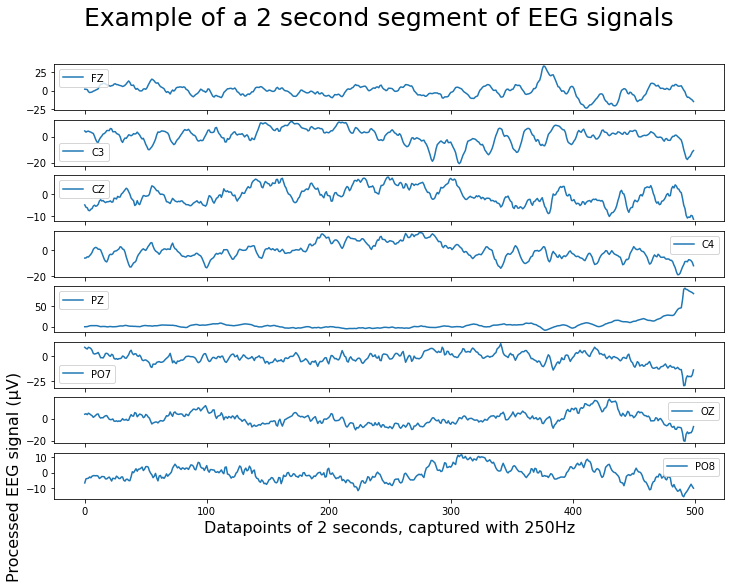

amount of good segments: 77
Good - relax: 38, legs: 39
Outliers - relax: 1, legs: 0
<DirEntry 'X02_2022-06-23_openloop_wet_09.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
<DirEntry 'X02_2022-06-23_openloop_wet_10.csv'>
amount of good segments: 78
Good - relax: 39, legs: 39
Outliers - relax: 0, legs: 0
Finished a preprocess pipeline.


In [5]:
list_of_freq_lim = [[[1,100]]]#, [[8,35]]]
freq_limits_names_list = [['1_100Hz']]#, '8_35Hz']
filt_orders = [2]
window_sizes = [500]    
data_preprocessing(list_of_freq_lim, freq_limits_names_list, filt_orders, window_sizes)